<a href="https://colab.research.google.com/github/ShivM99/Python-ML/blob/main/Amazon_ML_Challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Importing the libraries**

In [ ]:
import numpy as np
import pandas as pd
import requests as req
import imageio as io
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True # To be sure that truncated image do not raise an error
import cv2
from google.colab.patches import cv2_imshow
from multiprocessing import Pool

**Loading the dataset**

In [ ]:
data = pd.read_csv ('train.csv')
print (data.head ())
print (data.shape)

                                          image_link  group_id  entity_name  \
0  https://m.media-amazon.com/images/I/61I9XdN6OF...    748919  item_weight   
1  https://m.media-amazon.com/images/I/71gSRbyXmo...    916768  item_volume   
2  https://m.media-amazon.com/images/I/61BZ4zrjZX...    459516  item_weight   
3  https://m.media-amazon.com/images/I/612mrlqiI4...    459516  item_weight   
4  https://m.media-amazon.com/images/I/617Tl40LOX...    731432  item_weight   

     entity_value  
0      500.0 gram  
1         1.0 cup  
2      0.709 gram  
3      0.709 gram  
4  1400 milligram  
(263859, 4)


**Trying preprocessing on a small set of images**

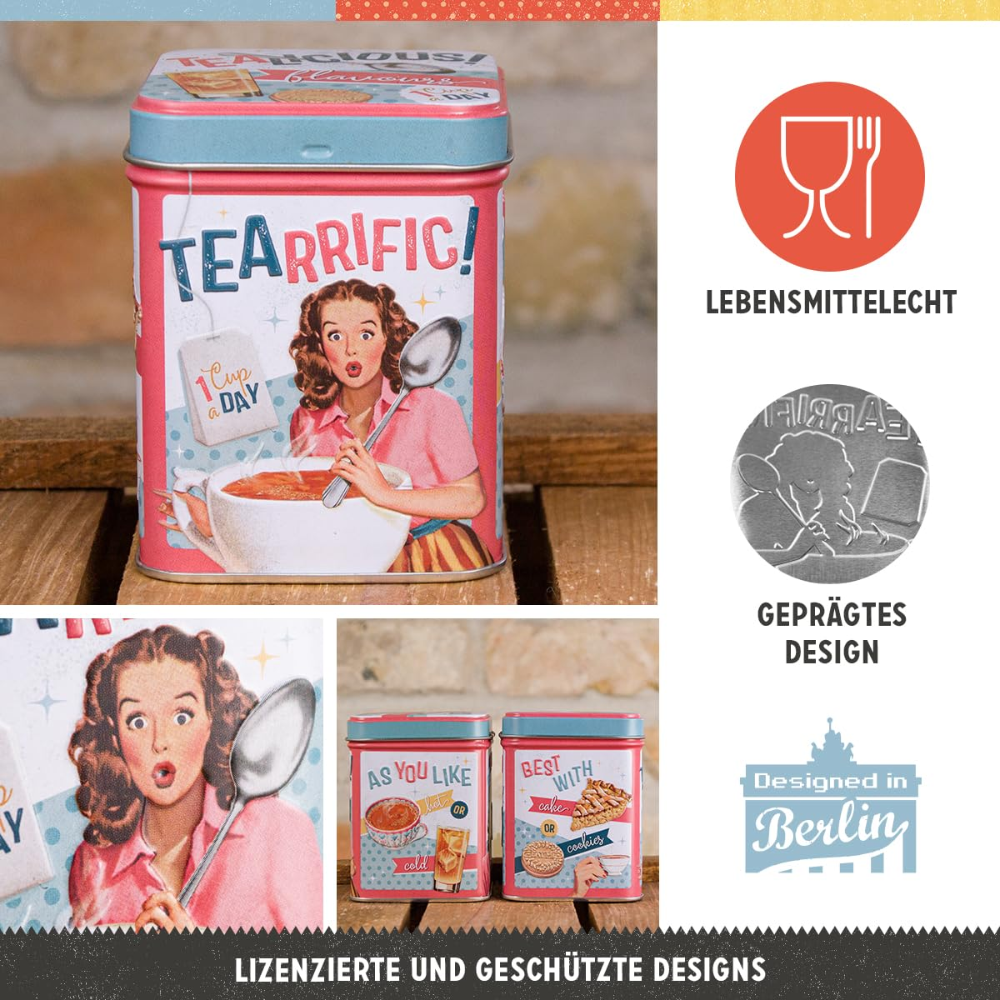

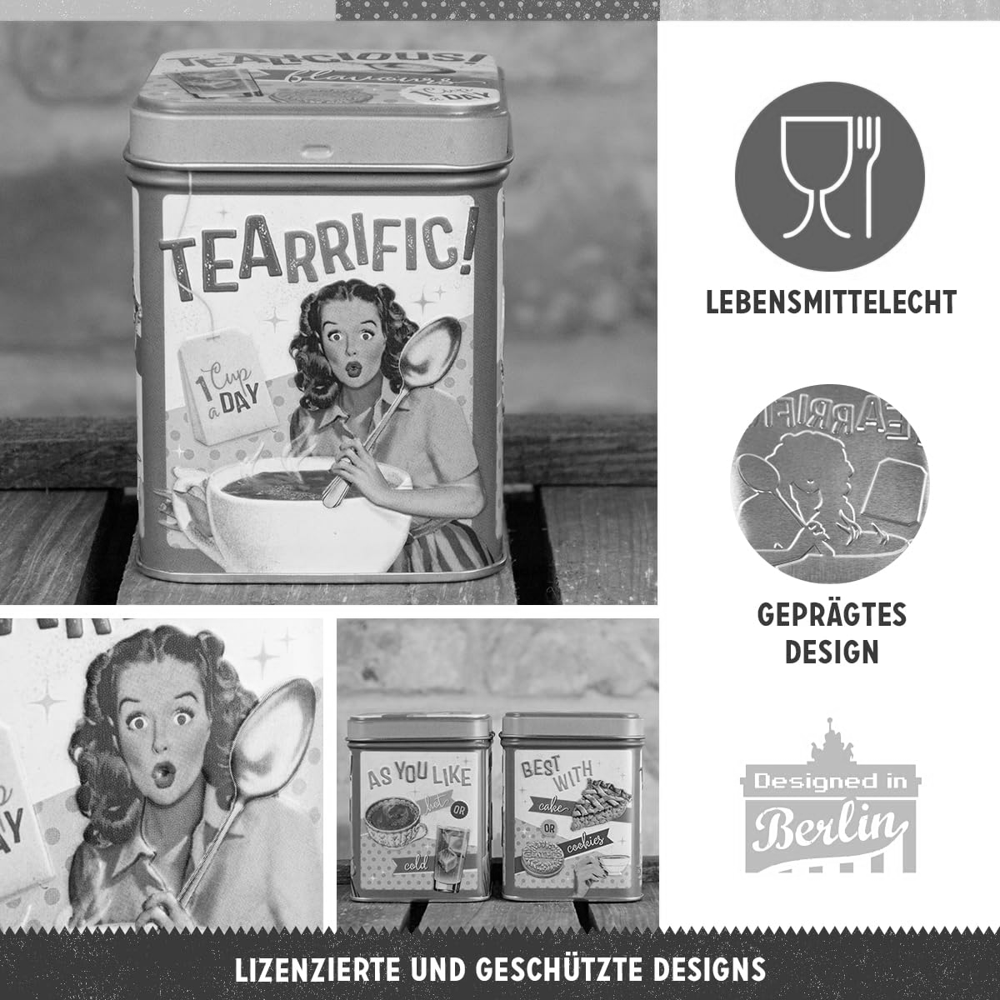

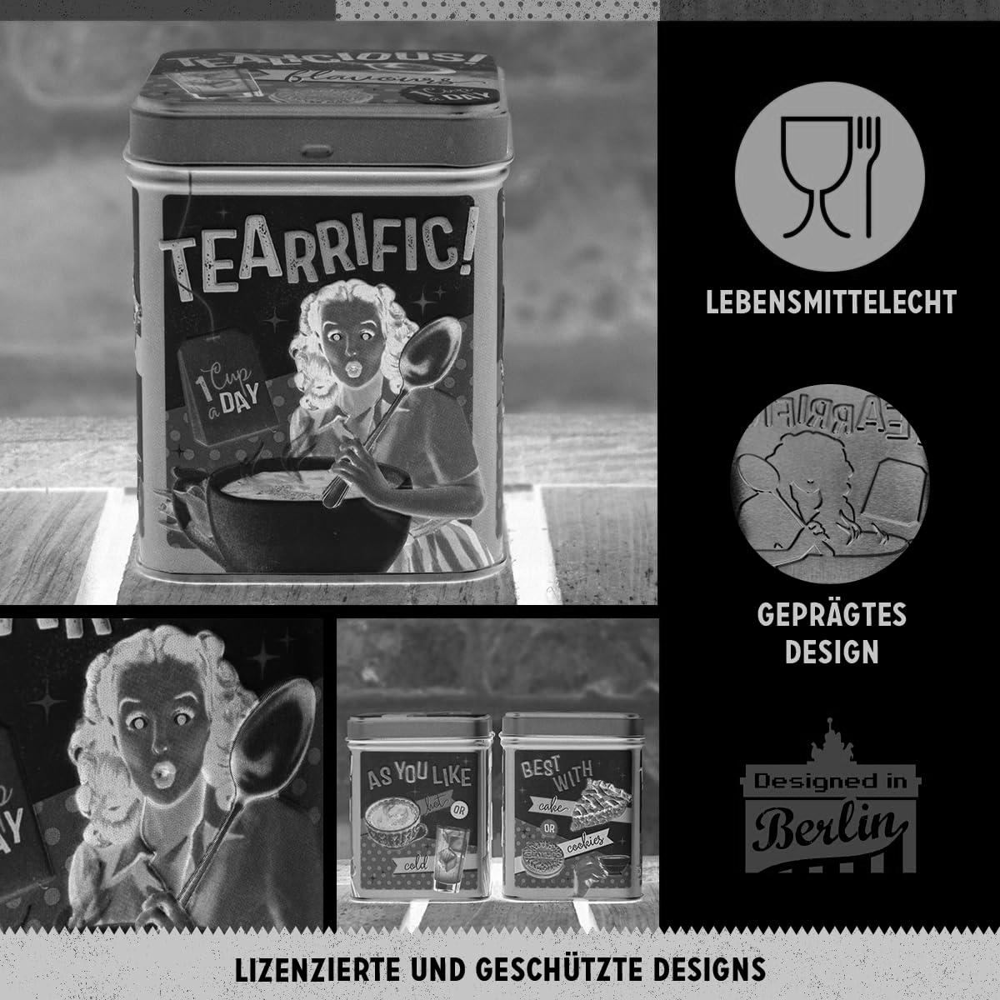

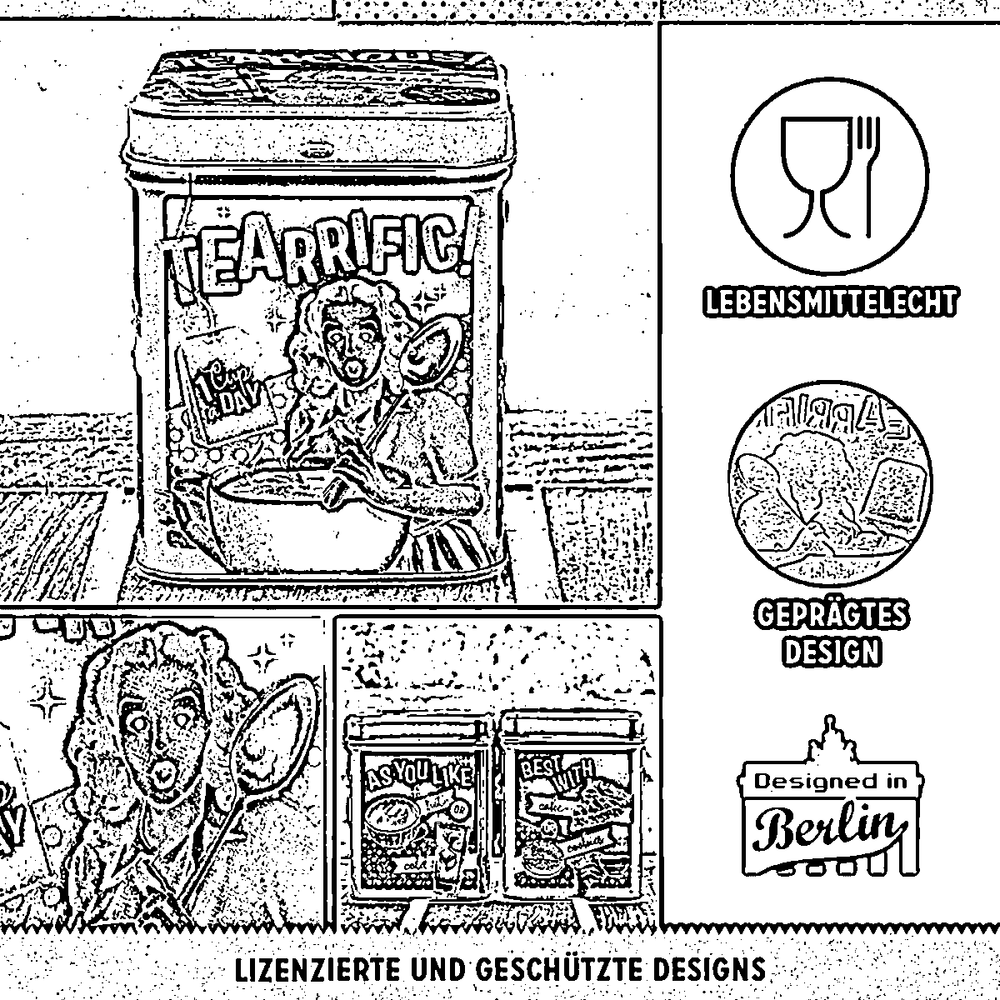

In [ ]:
img = cv2.cvtColor (io.v2.imread (data.iloc [1, 0]), cv2.COLOR_BGR2RGB)
cv2_imshow (img)
img = cv2.cvtColor (img, cv2.COLOR_RGB2GRAY)
cv2_imshow (img)
img = cv2.bitwise_not (img)
cv2_imshow (img)
img = cv2.adaptiveThreshold (img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 15, 3)
kernel = np.ones ((1, 1))
img = cv2.medianBlur (cv2.morphologyEx (img, cv2.MORPH_CLOSE, kernel), 3)
cv2_imshow (img)

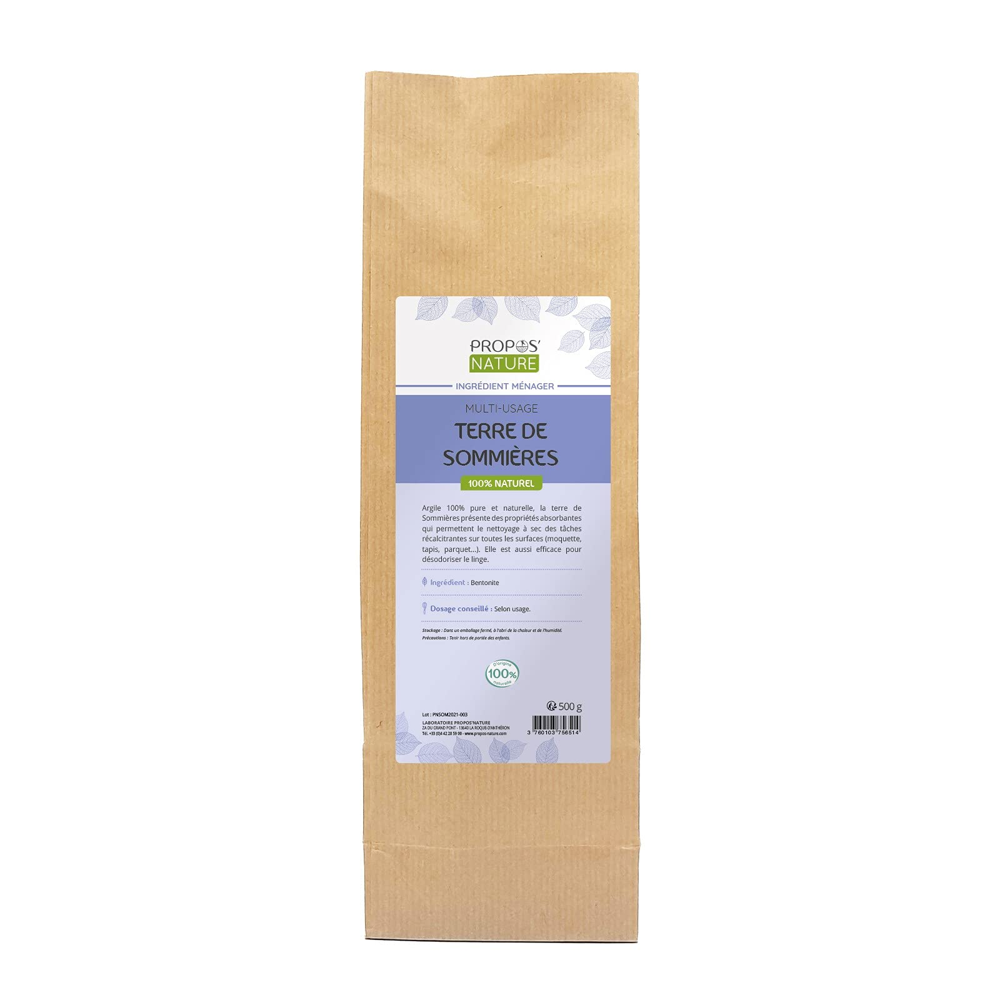

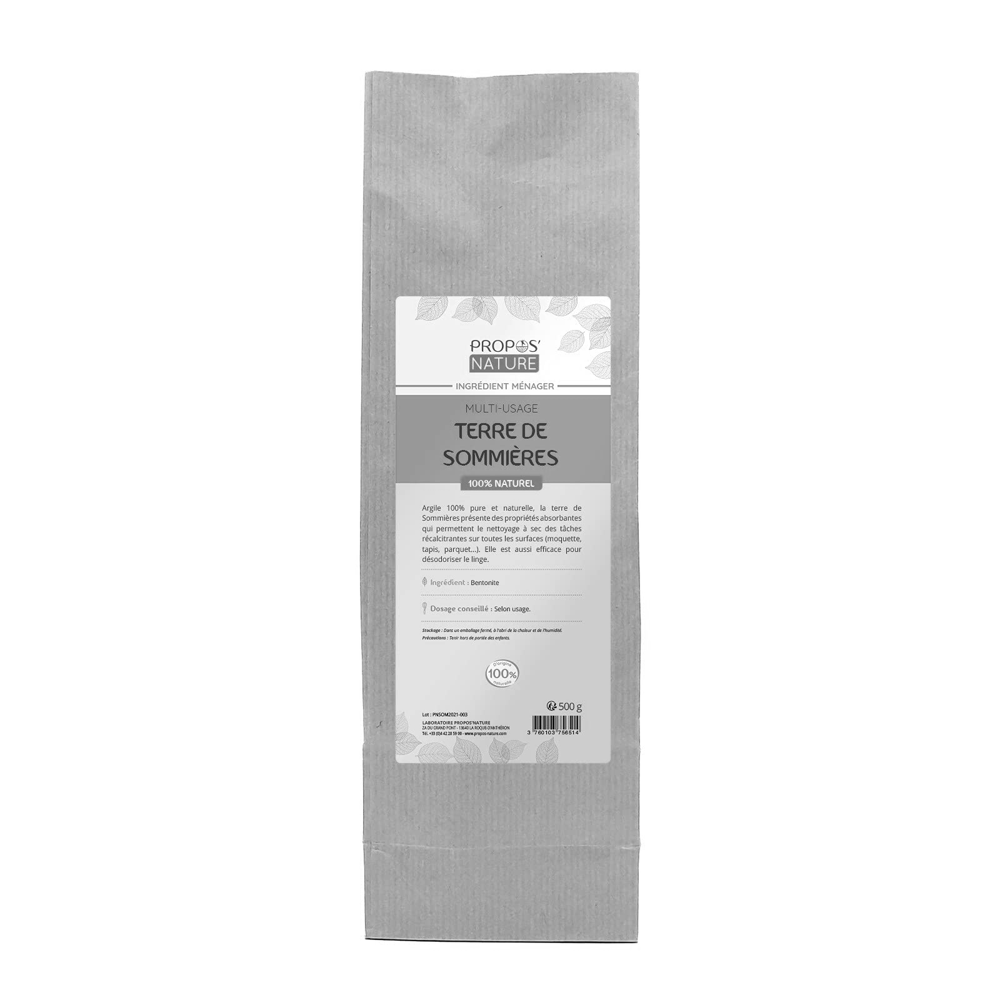

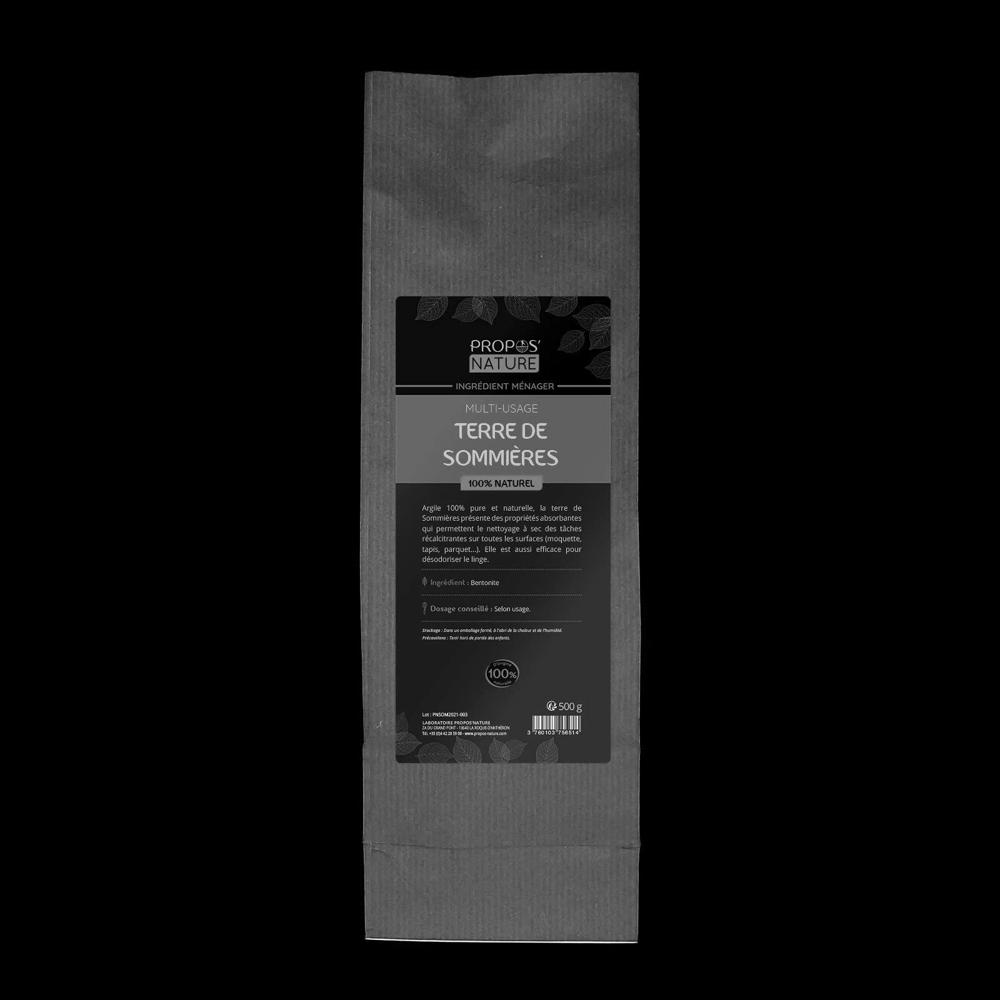

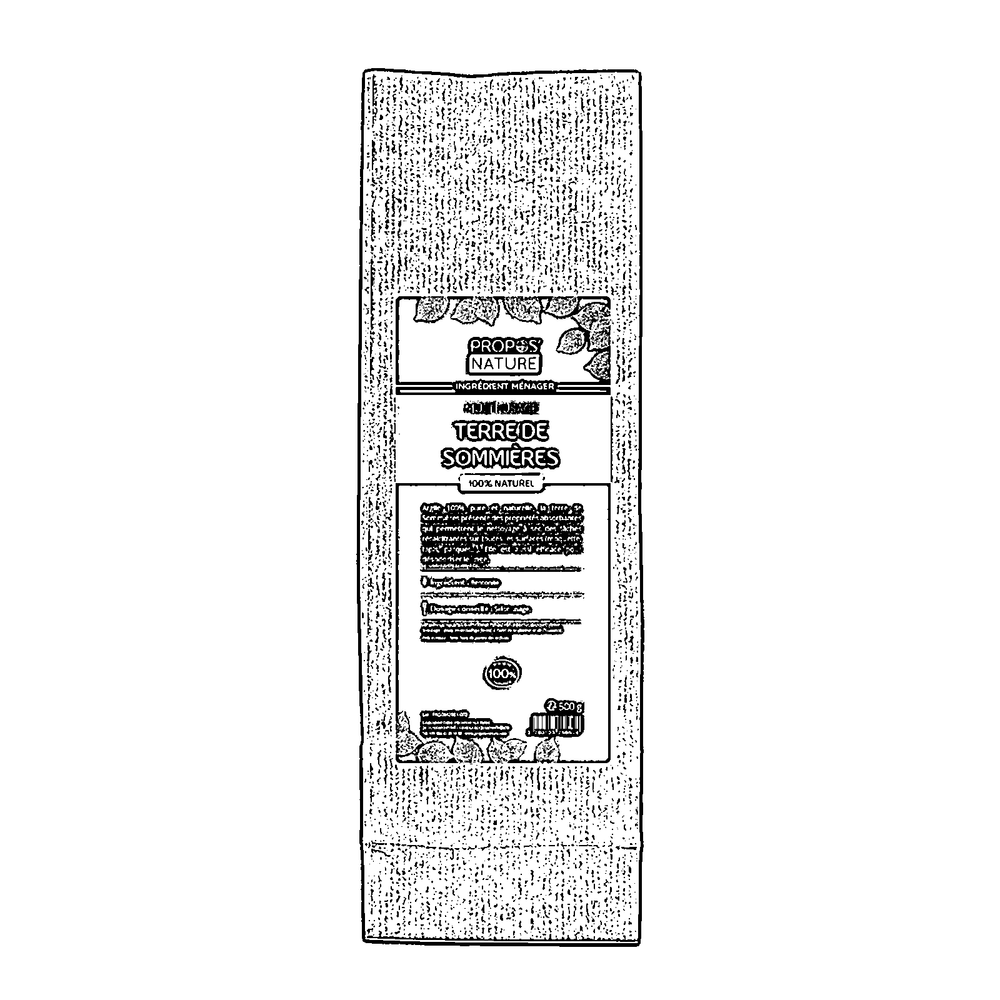

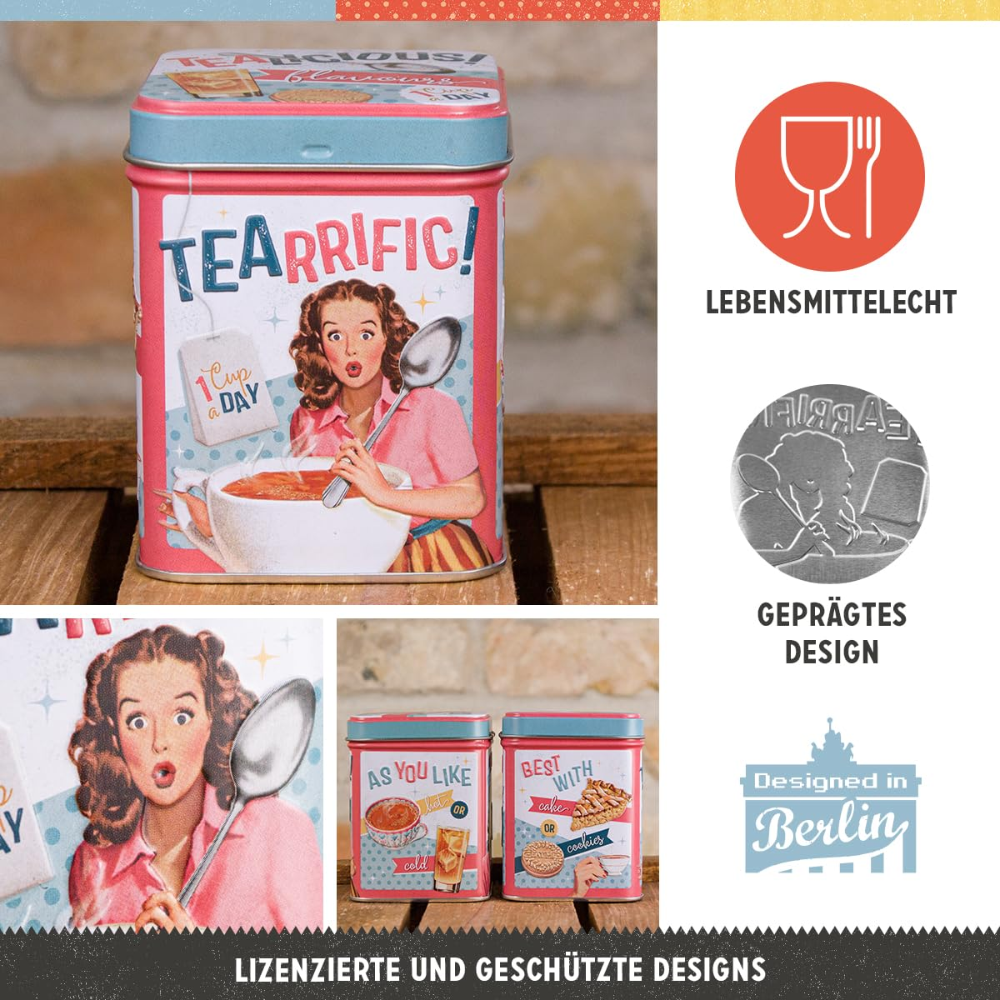

...

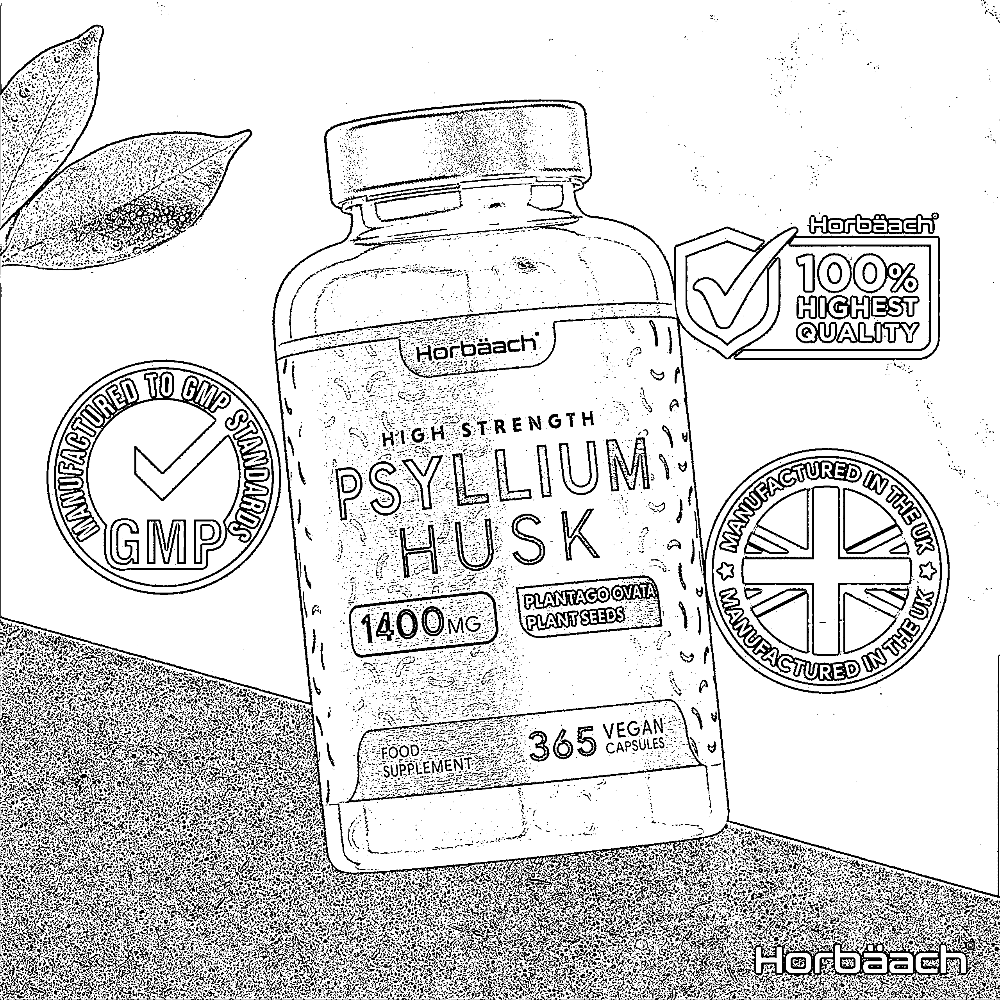

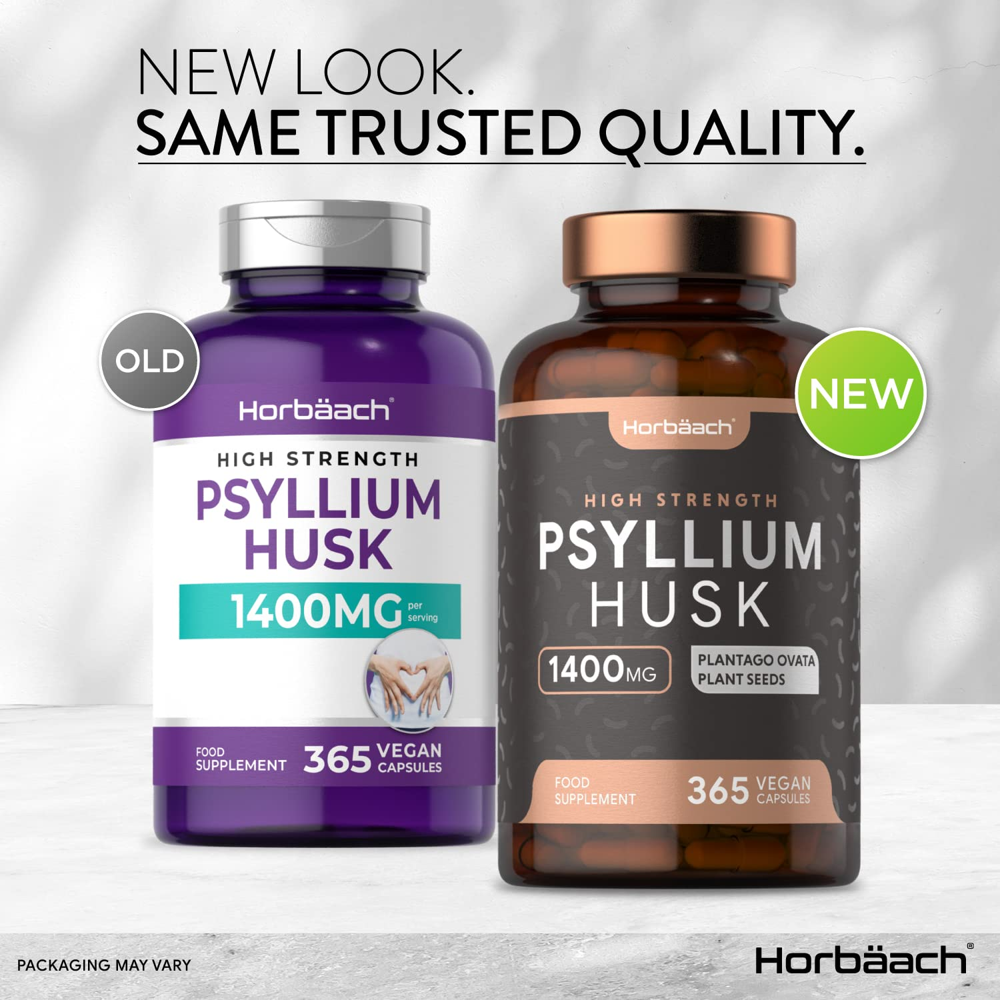

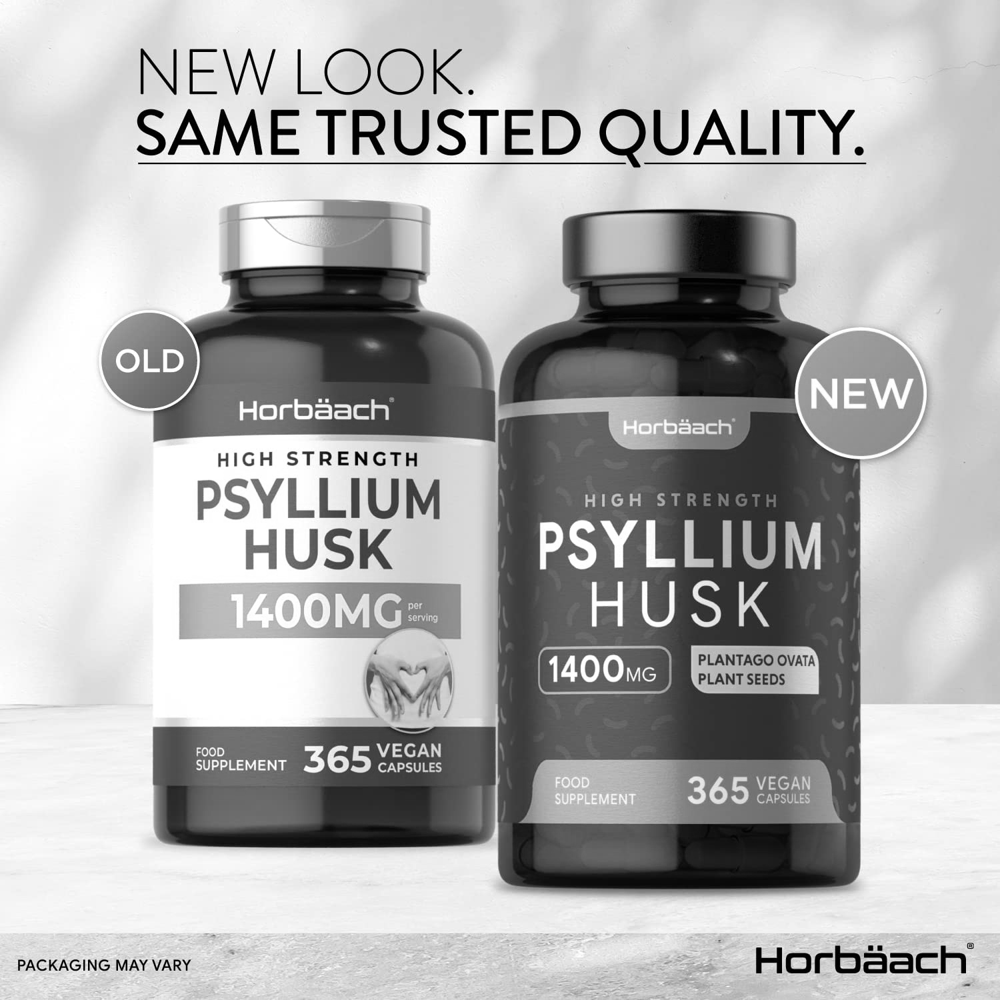

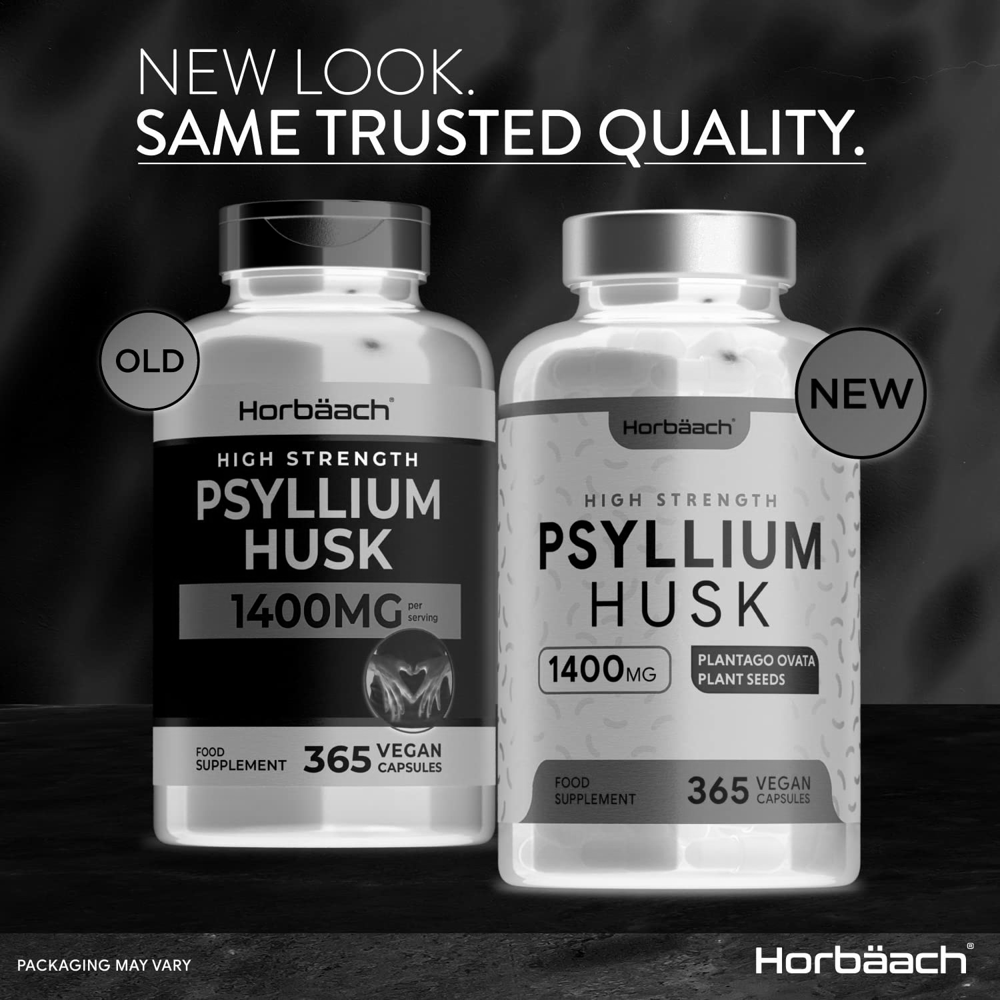

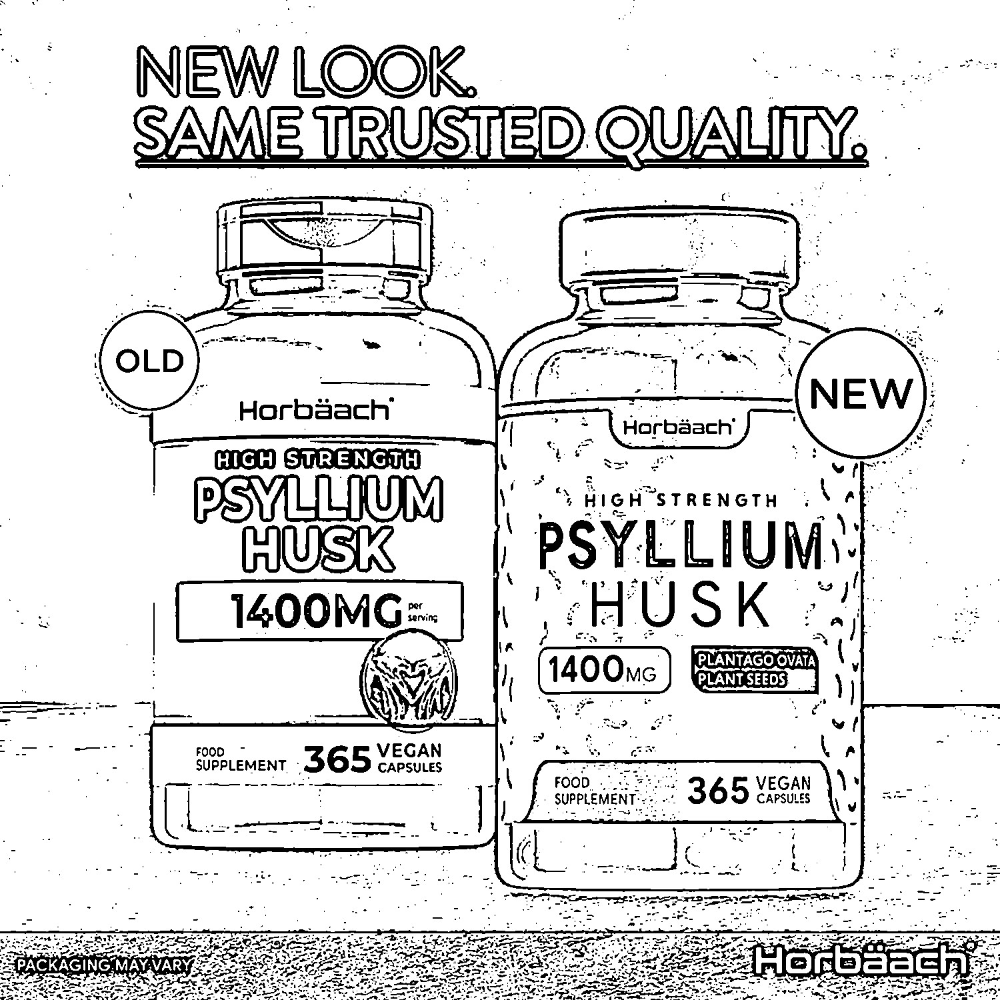

In [ ]:
for row in range (0, 10):
    img = cv2.cvtColor (io.v2.imread (data.iloc [row, 0]), cv2.COLOR_BGR2RGB)
    cv2_imshow (img)
    img = cv2.cvtColor (img, cv2.COLOR_RGB2GRAY)
    cv2_imshow (img)
    img = cv2.bitwise_not (img)
    cv2_imshow (img)
    img = cv2.adaptiveThreshold (img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 15, 3)
    kernel = np.ones ((1, 1))
    img = cv2.medianBlur (cv2.morphologyEx (img, cv2.MORPH_CLOSE, kernel), 3)
    cv2_imshow (img)

**Extracting images and preprocessing them one-by-one**

In [ ]:
row = 54 # Implementing preprocessing on 1 image
url = data.iloc [row, 0]
entity = data.iloc [row, 2]
value = data.iloc [row, 3]
filename = f'{row}_{entity}_{value}.jpg'
res = req.get (url, stream=True)
if res.status_code == 200:
    with open (filename, 'wb') as f:
        f.write (res.content)
        img = cv2.imread (filename)
        img = cv2.bitwise_not (cv2.cvtColor (img, cv2.COLOR_BGR2GRAY))
        cv2.imwrite (filename, img)
else:
    print(f'Failed to download {row} image')

In [ ]:
def image_extraction (row):
    url = data.iloc [row, 0]
    entity = data.iloc [row, 2]
    value = data.iloc [row, 3]
    filename = f'{row}_{entity}_{value}.jpg'
    res = req.get (url, stream=True)
    if res.status_code == 200:
        with open ('filenames.txt', 'a') as names:
            names.write (f'{filename}\t{entity}\t{value}\n')
            with open (filename, 'wb') as f:
                f.write (res.content)
                img = cv2.imread (filename)
                img = cv2.bitwise_not (cv2.cvtColor (img, cv2.COLOR_BGR2GRAY))
                cv2.imwrite (filename, img)
                return
    else:
        print(f'Failed to download {row} image')
        return

In [ ]:
if __name__ == '__main__':
    with Pool() as pool:
        for result in pool.imap (image_extraction, range (data.shape [0])): # Implementing preprocessing on all the 2.5 lakh images
            pass

**Final model on preprocessed data for OCR**

In [ ]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.3/281.3 kB 1.8 MB/s eta 0:00:00


In [ ]:
import easyocr as ocr
reader = ocr.Reader (['en'], gpu=True)
import matplotlib.pyplot as plt
import re

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

/usr/local/lib/python3.10/dist-packages/easyocr/detection.py:78: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net.load_state_dict(copyStateDict(torch.load(trained_model, ma

In [ ]:
img = cv2.imread ('/content/12_item_weight_3.53 ounce.jpg')
img = cv2.bitwise_not (cv2.cvtColor (img, cv2.COLOR_BGR2GRAY))
cv2_imshow (img)
result = reader.readtext (img)
for res in result:
    print (res)

([[1233, 415], [1533, 415], [1533, 499], [1233, 499]], 'Helps in', 0.7679770398584306)
([[1137, 492], [1626, 492], [1626, 567], [1137, 567]], 'osteoarthritis', 0.998705760045965)
([[2015, 463], [2324, 463], [2324, 559], [2015, 559]], 'Helps in', 0.9401635005504582)
([[2010, 546], [2353, 546], [2353, 635], [2010, 635]], 'digestion', 0.9999319700750655)
([[658, 652], [954, 652], [954, 724], [658, 724]], 'Reduces', 0.9998990140388172)
([[557, 727], [1046, 727], [1046, 803], [557, 803]], 'inflammation', 0.9996971685769923)
([[1299, 1144], [1374, 1144], [1374, 1174], [1299, 1174]], 'BASED', 0.9999795814736508)
([[246, 1160], [746, 1160], [746, 1234], [246, 1234]], 'Anti-bacterial', 0.997143892456564)
([[301, 1233], [690, 1233], [690, 1333], [301, 1333]], 'properties', 0.9979513273473709)
([[1913, 1705], [1979, 1705], [1979, 1775], [1913, 1775]], '60', 0.20128932458369989)
([[97, 1811], [402, 1811], [402, 1907], [97, 1907]], 'Helps in', 0.5231745853351639)
([[154, 1898], [350, 1898], [350, 1

In [ ]:
entity_unit_map = {
    'width': {'centimetre', 'foot', 'inch', 'metre', 'millimetre', 'yard'},
    'depth': {'centimetre', 'foot', 'inch', 'metre', 'millimetre', 'yard'},
    'height': {'centimetre', 'foot', 'inch', 'metre', 'millimetre', 'yard'},
    'item_weight': {'gram',
        'kilogram',
        'microgram',
        'milligram',
        'ounce',
        'pound',
        'ton'},
    'maximum_weight_recommendation': {'gram',
        'kilogram',
        'microgram',
        'milligram',
        'ounce',
        'pound',
        'ton'},
    'voltage': {'kilovolt', 'millivolt', 'volt'},
    'wattage': {'kilowatt', 'watt'},
    'item_volume': {'centilitre',
        'cubic foot',
        'cubic inch',
        'cup',
        'decilitre',
        'fluid ounce',
        'gallon',
        'imperial gallon',
        'litre',
        'microlitre',
        'millilitre',
        'pint',
        'quart'}
}
allowed_units = {unit for entity in entity_unit_map for unit in entity_unit_map[entity]} # Creating a set of all units

In [ ]:
patterns = {
    'item_weight': r'(\d+\.?\d*)\s*(g|gram|kg|kilogram|microgram|mg|milligram|oz|ounce|lb|pound|ton)',
    'maximum_weight_recommendation': r'(\d+\.?\d*)\s*(g|gram|kg|kilogram|microgram|mg|milligram|oz|ounce|lb|pound|ton)',
    'item_volume': r'(\d+\.?\d*)\s*(centilitre|cubic foot|cubic inch|cup|decilitre|fluid ounce|gallon|imperial gallon|litre|microlitre|millilitre|pint|quart)',
    'width': r'(\d+\.?\d*)\s*(cm|centimetre|foot|inch|m|metre|mm|millimetre|yard)',
    'depth': r'(\d+\.?\d*)\s*(cm|centimetre|foot|inch|m|metre|mm|millimetre|yard)',
    'height': r'(\d+\.?\d*)\s*(cm|centimetre|foot|inch|m|metre|mm|millimetre|yard)',
    'wattage': r'(\d+\.?\d*)\s*(kw|kilowatt|w|watt)',
    'voltage': r'(\d+\.?\d*)\s*(kv|kilovolt|mv|millivolt|v|volt)'
} # (\d+\.?\d*) means >=1 digits, followed by none or a single decimal, followed by >=0 digits

In [ ]:
prev_id = data.iloc [0, 1]
data['predicted_value'] = ''
for row in range (2500): # Implementing preprocessing on the 1st 2500 images
    url = data.iloc [row, 0]
    group_id = data.iloc [row, 1]
    entity = data.iloc [row, 2]
    value = data.iloc [row, 3]
    filename = f'{row}_{entity}_{value}.jpg'
    res = req.get (url, stream=True)
    if res.status_code == 200:
        with open (filename, 'wb') as f:
            f.write (res.content)
            img = cv2.imread (filename)
            img = cv2.bitwise_not (cv2.cvtColor (img, cv2.COLOR_BGR2GRAY))
            if row > 0 and group_id == prev_id and ocr_value != None:
                print (row, '\t', ocr_value.group())
                data.iloc[row, 4] = ocr_value.group()
                continue
            prev_id = group_id
            result = reader.readtext (img)
            if entity in patterns.keys():
                for res in result:
                    text = res [1].lower()
                    if 'ter' in text: text = text.replace ('ter', 'tre')
                    elif 'feet' in text: text = text.replace ('feet', 'foot')
                    ocr_value = re.search (patterns[entity], text)
                    if ocr_value != None:
                        magnitude = re.search (r'(\d+\.?\d*)', ocr_value.group()).group()
                        if magnitude in filename:
                            print (row, '\t', ocr_value.group())
                            data.iloc[row, 4] = ocr_value.group()
                            break
                    elif res == result[-1] and ocr_value == None:
                        print (row, '\t')
                        data.iloc[row, 4] = ''
    else:
        print (f'Failed to download {row} image')

0 	 500 g
1 	 1cup
2 	 0.709 g
3 	 0.709 g
4 	
5 	
6 	 1400mg
7 	 1400mg
8 	 1400mg
9 	 1400mg
10 	 30kg
11 	 10 kg
12 	


KeyboardInterrupt: 

In [ ]:
data = data.drop (columns=['predicted_value'])

In [ ]:
from imutils.object_detection import non_max_suppression

In [ ]:
import tarfile
with tarfile.open ("frozen_east_text_detection.tar.gz", "r:gz") as tar:
    tar.extractall()

In [ ]:
img = cv2.imread ('/content/1_item_volume_1.0 cup.jpg')
net = cv2.dnn.readNet ('frozen_east_text_detection.pb')

In [ ]:
(newH, newW) = (1280, 640) # Must be in the multiple of 32 as the EAST model was trained on such images
img = cv2.resize (img, (newH, newW))
(H, W) = img.shape [: 2]

In [ ]:
layer_names = ['feature_fusion/Conv_7/Sigmoid', 'feature_fusion/concat_3']
# 1st layer name give us the confidence score woth which the model detects the text
# 2nd layer name give us the orientation/geometry of the text, which is useful to draw a box around the text

In [ ]:
blob = cv2.dnn.blobFromImage (img, 1.0, (W, H), (123.68, 116.78, 103.94), swapRB=True, crop=False)
# (mean R, mean G, mean B) used by the authors to train their model
# swapRB means to convert the image from BGR (used by OpenCV) to RGB (used by EAST))
# We don't want to crop the image

In [ ]:
net.setInput (blob)
(scores, geometry) = net.forward (layer_names)
print (scores.shape) # (batch_size, channels, height, width)
(numRows, numCols) = scores.shape [2:]

(1, 1, 160, 320)


In [ ]:
confidences = []
rects = []